<a href="https://colab.research.google.com/github/MeerBaloch7/GAN_monet_to_photos_transfer/blob/main/ML_03.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import glob
from tqdm import tqdm
from IPython.display import clear_output
from tensorflow.keras.applications.inception_v3 import InceptionV3
from scipy import linalg


In [ ]:
# Configuration
AUTOTUNE = tf.data.AUTOTUNE
BUFFER_SIZE = 1000
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256
LAMBDA_CYCLE = 10.0
LAMBDA_IDENTITY = 5.0  # As in your original code
EPOCHS = 15
CHECKPOINT_PATH = "./checkpoints/monet_cyclegan"

In [ ]:
# Create directories for checkpoints and results
os.makedirs("./checkpoints/monet_cyclegan", exist_ok=True)
os.makedirs("./results", exist_ok=True)

In [ ]:
MONET_PATH = "/content/drive/MyDrive/GAN/monet_jpg"
PHOTO_PATH = "/content/drive/MyDrive/GAN/photo_jpg"
TEST_PHOTO_PATH = "/content/drive/MyDrive/GAN/test_photos"

In [ ]:
# Data Preprocessing Functions
def preprocess_img(img):
    img = tf.cast(img, tf.float32)
    img = (img / 127.5) - 1  # Scale to [-1, 1]
    return img

def random_jitter(image):
    # Resize to bigger than target size
    image = tf.image.resize(image, [286, 286])
    # Random crop back to target size
    image = tf.image.random_crop(image, size=[IMG_HEIGHT, IMG_WIDTH, 3])
    # Random mirroring
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
    return image

def load_dataset(path, batch_size=BATCH_SIZE, train=True):
    # Check if path exists
    if not os.path.exists(path):
        raise ValueError(f"Path not found: {path}")

    # Get all jpg files in the directory
    image_paths = glob.glob(os.path.join(path, "*.jpg"))

    # Limit photo dataset to 5000 images
    if 'photo' in path.lower():
        image_paths = sorted(image_paths)[:5000]

    if len(image_paths) == 0:
        raise ValueError(f"No jpg images found in: {path}")

    print(f"Found {len(image_paths)} images in {path}")

    # Create a dataset from the file paths
    dataset = tf.data.Dataset.from_tensor_slices(image_paths)

    # Load and preprocess the images
    def load_and_preprocess(file_path):
        img = tf.io.read_file(file_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [IMG_HEIGHT, IMG_WIDTH])

        if train:
            img = random_jitter(img)

        return preprocess_img(img)

    dataset = dataset.map(load_and_preprocess, num_parallel_calls=AUTOTUNE)

    if train:
        dataset = dataset.shuffle(BUFFER_SIZE)

    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(AUTOTUNE)

    return dataset


In [ ]:
class InstanceNormalization(layers.Layer):
    def __init__(self, epsilon=1e-5, **kwargs):
        super(InstanceNormalization, self).__init__(**kwargs)
        self.epsilon = epsilon

    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=(input_shape[-1],),
            initializer='ones',
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=(input_shape[-1],),
            initializer='zeros',
            trainable=True)
        super(InstanceNormalization, self).build(input_shape)

    def call(self, x):
        mean, var = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        return self.scale * (x - mean) / tf.sqrt(var + self.epsilon) + self.offset

# Residual block
def resnet_block(x, filters=256):
    res = layers.Conv2D(filters, 3, padding='same', use_bias=False)(x)
    res = InstanceNormalization()(res)
    res = layers.ReLU()(res)

    res = layers.Conv2D(filters, 3, padding='same', use_bias=False)(res)
    res = InstanceNormalization()(res)

    return layers.Add()([x, res])

# ResNet Generator model
def build_generator(img_height=256, img_width=256):
    initializer = tf.random_normal_initializer(0., 0.02)
    inputs = layers.Input(shape=(img_height, img_width, 3))

    # Initial conv
    x = layers.Conv2D(64, 7, padding='same', kernel_initializer=initializer, use_bias=False)(inputs)
    x = InstanceNormalization()(x)
    x = layers.ReLU()(x)

    # Downsampling
    for filters in [128, 256]:
        x = layers.Conv2D(filters, 3, strides=2, padding='same', kernel_initializer=initializer, use_bias=False)(x)
        x = InstanceNormalization()(x)
        x = layers.ReLU()(x)

    # ResNet blocks
    for _ in range(6):
        x = resnet_block(x)

    # Upsampling
    for filters in [128, 64]:
        x = layers.Conv2DTranspose(filters, 3, strides=2, padding='same', kernel_initializer=initializer, use_bias=False)(x)
        x = InstanceNormalization()(x)
        x = layers.ReLU()(x)

    # Output layer
    x = layers.Conv2D(3, 7, padding='same', kernel_initializer=initializer)(x)
    outputs = layers.Activation('tanh')(x)

    return keras.Model(inputs, outputs, name="ResNetGenerator")

In [ ]:
# -----------------------------
# Discriminator (PatchGAN)
# -----------------------------
def build_discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inputs = layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3))

    # First layer doesn't use instance normalization
    x = layers.Conv2D(64, 4, strides=2, padding='same',
                     kernel_initializer=initializer)(inputs)
    x = layers.LeakyReLU(0.2)(x)

    # Additional layers
    filter_sizes = [128, 256, 512]
    for filter_size in filter_sizes:
        x = layers.Conv2D(filter_size, 4, strides=2, padding='same',
                         kernel_initializer=initializer, use_bias=False)(x)
        x = InstanceNormalization()(x)
        x = layers.LeakyReLU(0.2)(x)

    # Final layer (1x1 PatchGAN)
    x = layers.Conv2D(1, 4, padding='same',
                     kernel_initializer=initializer)(x)

    return keras.Model(inputs=inputs, outputs=x)


In [ ]:
# -----------------------------
# Loss Functions (keeping your original loss functions)
# -----------------------------
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)
L1 = tf.keras.losses.MeanAbsoluteError()

def discriminator_loss(real, fake):
    real_loss = loss_obj(tf.ones_like(real), real)
    fake_loss = loss_obj(tf.zeros_like(fake), fake)
    return 0.5 * (real_loss + fake_loss)

def generator_loss(fake):
    return loss_obj(tf.ones_like(fake), fake)

def cycle_loss(real, cycled):
    return L1(real, cycled) * LAMBDA_CYCLE

def identity_loss(real, same):
    return L1(real, same) * LAMBDA_IDENTITY

In [ ]:
# -----------------------------
# Generate and Save Sample Images
# -----------------------------
def generate_images(G, test_input, epoch, save_path=None):
    prediction = G(test_input, training=False)

    fig = plt.figure(figsize=(12, 6))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Photo', 'Monet-style Output']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)  # Denormalize back to [0, 1]
        plt.axis('off')

    plt.tight_layout()

    if save_path is not None:
        plt.savefig(save_path)

    plt.show()
    return prediction[0]


In [ ]:

# -----------------------------
# FID Score Calculation
# -----------------------------
def calculate_fid_score(real_images, generated_images, batch_size=50):
    """
    Calculate Fréchet Inception Distance between real and generated images
    """
    # Load InceptionV3 model (pretrained on ImageNet) for feature extraction
    inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    # Function to extract features
    def extract_features(images):
        # Resize images to InceptionV3 input size
        images_resized = tf.image.resize(images, (299, 299))
        # Convert from [-1, 1] to [0, 255] range for InceptionV3
        images_resized = (images_resized + 1) * 127.5
        # Preprocess for InceptionV3
        images_resized = tf.keras.applications.inception_v3.preprocess_input(images_resized)

        # Extract features batch by batch
        all_features = []
        num_batches = len(images) // batch_size + (1 if len(images) % batch_size != 0 else 0)

        for i in range(num_batches):
            start_idx = i * batch_size
            end_idx = min((i + 1) * batch_size, len(images))
            batch = images_resized[start_idx:end_idx]
            features = inception_model.predict(batch)
            all_features.append(features)

        return np.concatenate(all_features, axis=0)

    # Extract features from real and generated images
    print("Extracting features from real images...")
    real_features = extract_features(real_images)

    print("Extracting features from generated images...")
    gen_features = extract_features(generated_images)

    # Calculate statistics (mean and covariance)
    mu_real = np.mean(real_features, axis=0)
    sigma_real = np.cov(real_features, rowvar=False)

    mu_gen = np.mean(gen_features, axis=0)
    sigma_gen = np.cov(gen_features, rowvar=False)

    # Calculate FID
    ssdiff = np.sum((mu_real - mu_gen) ** 2.0)
    covmean = linalg.sqrtm(sigma_real.dot(sigma_gen))

    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = ssdiff + np.trace(sigma_real + sigma_gen - 2.0 * covmean)

    return fid


In [ ]:
# -----------------------------
# Training Step
# -----------------------------
@tf.function
def train_step(real_X, real_Y, G_XtoY, G_YtoX, D_X, D_Y, g_optimizer, d_X_optimizer, d_Y_optimizer):
    with tf.GradientTape() as tape_gen, tf.GradientTape() as tape_disc_x, tf.GradientTape() as tape_disc_y: # Create separate tapes for disc_x and disc_y
        # Generate images
        fake_Y = G_XtoY(real_X, training=True)  # Photo to Monet
        cycled_X = G_YtoX(fake_Y, training=True)  # Monet back to Photo
        fake_X = G_YtoX(real_Y, training=True)  # Monet to Photo
        cycled_Y = G_XtoY(fake_X, training=True)  # Photo back to Monet

        # Same image (identity)
        same_X = G_YtoX(real_X, training=True)
        same_Y = G_XtoY(real_Y, training=True)

        # Discriminator outputs
        disc_real_X = D_X(real_X, training=True)
        disc_fake_X = D_X(fake_X, training=True)
        disc_real_Y = D_Y(real_Y, training=True)
        disc_fake_Y = D_Y(fake_Y, training=True)

        # Calculate losses
        gen_G_loss = generator_loss(disc_fake_Y) + \
                       cycle_loss(real_X, cycled_X) + \
                       identity_loss(real_Y, same_Y)
        gen_F_loss = generator_loss(disc_fake_X) + \
                       cycle_loss(real_Y, cycled_Y) + \
                       identity_loss(real_X, same_X)
        total_gen_loss = gen_G_loss + gen_F_loss # Combine generator losses

        disc_X_loss = discriminator_loss(disc_real_X, disc_fake_X)
        disc_Y_loss = discriminator_loss(disc_real_Y, disc_fake_Y)

    # Get gradients and apply them to the optimizers
    gen_gradients = tape_gen.gradient(total_gen_loss, # Use combined loss for generator gradients
                                      G_XtoY.trainable_variables + G_YtoX.trainable_variables)
    disc_X_gradients = tape_disc_x.gradient(disc_X_loss, D_X.trainable_variables) # Use tape_disc_x for D_X
    disc_Y_gradients = tape_disc_y.gradient(disc_Y_loss, D_Y.trainable_variables) # Use tape_disc_y for D_Y


    g_optimizer.apply_gradients(zip(gen_gradients, G_XtoY.trainable_variables + G_YtoX.trainable_variables))
    d_X_optimizer.apply_gradients(zip(disc_X_gradients, D_X.trainable_variables))
    d_Y_optimizer.apply_gradients(zip(disc_Y_gradients, D_Y.trainable_variables))


    return {'gen_G_loss': gen_G_loss,
            'gen_F_loss': gen_F_loss,
            'disc_X_loss': disc_X_loss,
            'disc_Y_loss': disc_Y_loss}

In [ ]:
# -----------------------------
# Main Training Loop
# -----------------------------
def train(G_XtoY, G_YtoX, D_X, D_Y, photo_ds, monet_ds, epochs=EPOCHS):
    # Create optimizers
    g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    d_X_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    d_Y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    # Checkpoint setup
    checkpoint_prefix = os.path.join(CHECKPOINT_PATH, "ckpt")
    checkpoint = tf.train.Checkpoint(
    generator_g=G_XtoY,
    generator_f=G_YtoX,
    discriminator_x=D_X,
    discriminator_y=D_Y,
    g_optimizer=g_optimizer,
    d_X_optimizer=d_X_optimizer,
    d_Y_optimizer=d_Y_optimizer
)


    # Try to restore from checkpoint
    latest_checkpoint = tf.train.latest_checkpoint(CHECKPOINT_PATH)
    if latest_checkpoint:
        print(f"Restoring from checkpoint: {latest_checkpoint}")
        checkpoint.restore(latest_checkpoint)
        print("Checkpoint restored!")

    # Keep track of the losses over time
    gen_G_losses = []
    gen_F_losses = []
    disc_X_losses = []
    disc_Y_losses = []

    for epoch in range(epochs):
        start = time.time()

        # Training loop
        n = 0
        total_gen_G_loss = 0
        total_gen_F_loss = 0
        total_disc_X_loss = 0
        total_disc_Y_loss = 0

        # Progress bar
        num_batches = tf.data.experimental.cardinality(photo_ds).numpy()
        progress_bar = tqdm(total=num_batches, desc=f"Epoch {epoch+1}/{epochs}")

        for (real_X, real_Y) in tf.data.Dataset.zip((photo_ds, monet_ds)):
            losses = train_step(real_X, real_Y, G_XtoY, G_YtoX, D_X, D_Y, g_optimizer, d_X_optimizer, d_Y_optimizer)

            total_gen_G_loss += losses['gen_G_loss']
            total_gen_F_loss += losses['gen_F_loss']
            total_disc_X_loss += losses['disc_X_loss']
            total_disc_Y_loss += losses['disc_Y_loss']

            n += 1
            progress_bar.update(1)

        progress_bar.close()

        # Calculate average losses
        avg_gen_G_loss = total_gen_G_loss / n
        avg_gen_F_loss = total_gen_F_loss / n
        avg_disc_X_loss = total_disc_X_loss / n
        avg_disc_Y_loss = total_disc_Y_loss / n

        # Save the losses for plotting
        gen_G_losses.append(avg_gen_G_loss)
        gen_F_losses.append(avg_gen_F_loss)
        disc_X_losses.append(avg_disc_X_loss)
        disc_Y_losses.append(avg_disc_Y_loss)

        # Print the loss information
        print(f"Epoch {epoch+1}/{epochs}")
        print(f"  Generator G (Photo → Monet) loss: {avg_gen_G_loss:.4f}")
        print(f"  Generator F (Monet → Photo) loss: {avg_gen_F_loss:.4f}")
        print(f"  Discriminator X (Photo) loss: {avg_disc_X_loss:.4f}")
        print(f"  Discriminator Y (Monet) loss: {avg_disc_Y_loss:.4f}")
        print(f"  Time taken: {time.time()-start:.2f} sec\n")

        # Save checkpoint
        if (epoch + 1) % 5 == 0 or epoch == epochs - 1:
            checkpoint.save(file_prefix=checkpoint_prefix)
            print(f"Checkpoint saved at epoch {epoch+1}")

        # Generate sample images
        for sample_X in photo_ds.take(2):  # Generate from 2 sample photos
            sample_idx = np.random.randint(0, 1000)  # Random identifier for the saved image
            generate_images(
                G_XtoY,
                sample_X,
                epoch,
                save_path=f"./results/epoch_{epoch+1}_sample_{sample_idx}.png"
            )

    # Plot loss curves
    plt.figure(figsize=(12, 8))
    plt.subplot(2, 1, 1)
    plt.plot(gen_G_losses, label='Generator G (Photo → Monet)')
    plt.plot(gen_F_losses, label='Generator F (Monet → Photo)')
    plt.title('Generator Losses')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(2, 1, 2)
    plt.plot(disc_X_losses, label='Discriminator X (Photo)')
    plt.plot(disc_Y_losses, label='Discriminator Y (Monet)')
    plt.title('Discriminator Losses')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.savefig('./results/loss_curves.png')
    plt.show()

    return G_XtoY, G_YtoX, D_X, D_Y



In [ ]:
# -----------------------------
# Generate from Test Photos
# -----------------------------
def generate_test_images(G_XtoY, test_dataset):
    # Create directory for test results if it doesn't exist
    os.makedirs("./results/test_results", exist_ok=True)

    # List to store generated images for FID calculation
    generated_images = []

    # Generate images for each test photo
    print("Generating Monet-style images from test photos...")
    for idx, test_photo in enumerate(tqdm(test_dataset)):
        # Generate Monet-style image
        generated_img = G_XtoY(test_photo, training=False)
        generated_images.append(generated_img[0])

        # Save the first 30 images for visual inspection
        if idx < 30:
            fig = plt.figure(figsize=(12, 6))

            plt.subplot(1, 2, 1)
            plt.title('Original Photo')
            plt.imshow(test_photo[0] * 0.5 + 0.5)
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.title('Monet-style Output')
            plt.imshow(generated_img[0] * 0.5 + 0.5)
            plt.axis('off')

            plt.savefig(f"./results/test_results/test_{idx}.png")
            plt.close()

    return np.array(generated_images)


In [ ]:
# -----------------------------
# Main Function
# -----------------------------
def main():
    # Load datasets
    try:
      print("Loading Monet dataset...")
      monet_dataset = load_dataset(MONET_PATH, train=True)

      print("Loading photo dataset...")
      photo_dataset = load_dataset(PHOTO_PATH, train=True)

      print("Loading test photo dataset...")
      test_dataset = load_dataset(TEST_PHOTO_PATH, train=False)
    except ValueError as e:
        print(f"Error loading datasets: {e}")


    # Build models
    print("Building models...")
    G_XtoY = build_generator()  # Photo to Monet
    G_YtoX = build_generator()  # Monet to Photo
    D_X = build_discriminator()  # Discriminator for photos (X domain)
    D_Y = build_discriminator()  # Discriminator for Monet paintings (Y domain)

    # Print model summaries
    print("\nGenerator Summary:")
    G_XtoY.summary()

    print("\nDiscriminator Summary:")
    D_X.summary()

    # Train the model
    print("\nStarting training...")
    G_XtoY, G_YtoX, D_X, D_Y = train(G_XtoY, G_YtoX, D_X, D_Y, photo_dataset, monet_dataset)

    # Generate images from test photos
    print("\nGenerating Monet-style images from test photos...")
    generated_images = generate_test_images(G_XtoY, test_dataset)

    # Calculate FID Score
    print("\nCollecting real Monet images for FID calculation...")
    # Get a sample of real Monet images for FID calculation
    real_monet_images = []
    for batch in monet_dataset.take(100):  # Use 100 images for FID calculation
        for img in batch:
            real_monet_images.append(img)
    real_monet_images = np.array(real_monet_images)

    print(f"Calculating FID score between {len(real_monet_images)} real Monet images and {len(generated_images)} generated images...")
    fid_score = calculate_fid_score(real_monet_images, generated_images)

    print(f"\nFID Score: {fid_score:.4f}")

    # Save FID score to file
    with open("./results/fid_score.txt", "w") as f:
        f.write(f"FID Score: {fid_score:.4f}")

    print("\nTraining and evaluation complete!")
    print(f"Results saved in ./results/")


Loading Monet dataset...
Found 300 images in /content/drive/MyDrive/GAN/monet_jpg
Loading photo dataset...
Found 5000 images in /content/drive/MyDrive/GAN/photo_jpg
Loading test photo dataset...
Found 400 images in /content/drive/MyDrive/GAN/test_photos
Building models...

Generator Summary:


Model: "ResNetGenerator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_136 (Conv2D) │ (None, 256, 256,  │      9,408 │ input_layer_5[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_normaliza… │ (None, 256, 256,  │        128 │ conv2d_136[0][0]  │
│ (InstanceNormaliza… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_22 (ReLU)     │ (None, 256, 256,  │          0 │ instance_normali… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_137 (Conv2D) │ (None, 128, 128,  │     73,728 │ re_lu_22[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_normaliza… │ (None, 128, 128,  │        256 │ conv2d_137[0][0]  │
│ (InstanceNormaliza… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_23 (ReLU)     │ (None, 128, 128,  │          0 │ instance_normali… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_138 (Conv2D) │ (None, 64, 64,    │    294,912 │ re_lu_23[0][0]    │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_normaliza… │ (None, 64, 64,    │        512 │ conv2d_138[0][0]  │
│ (InstanceNormaliza… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_24 (ReLU)     │ (None, 64, 64,    │          0 │ instance_normali… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_139 (Conv2D) │ (None, 64, 64,    │    589,824 │ re_lu_24[0][0]    │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_normaliza… │ (None, 64, 64,    │        512 │ conv2d_139[0][0]  │
│ (InstanceNormaliza… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_25 (ReLU)     │ (None, 64, 64,    │          0 │ instance_normali… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_140 (Conv2D) │ (None, 64, 64,    │    589,824 │ re_lu_25[0][0]    │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_normaliza… │ (None, 64, 64,    │        512 │ conv2d_140[0][0]  │
│ (InstanceNormaliza… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 64, 64,    │          0 │ re_lu_24[0][0],   │
│                     │ 256)              │            │ instance_normali… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_141 (Conv2D) │ (None, 64, 64,    │    589,824 │ add_12[0][0]    

 Total params: 7,841,411 (29.91 MB)

 Trainable params: 7,841,411 (29.91 MB)

 Non-trainable params: 0 (0.00 B)


Discriminator Summary:


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_168 (Conv2D)             │ (None, 128, 128, 64)   │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_8 (LeakyReLU)       │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 64, 64, 128)    │       131,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_normalization_74       │ (None, 64, 64, 128)    │           256 │
│ (InstanceNormalization)         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_9 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 32, 32, 256)    │       524,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_normalization_75       │ (None, 32, 32, 256)    │           512 │
│ (InstanceNormalization)         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_10 (LeakyReLU)      │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_normalization_76       │ (None, 16, 16, 512)    │         1,024 │
│ (InstanceNormalization)         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_11 (LeakyReLU)      │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_172 (Conv2D)             │ (None, 16, 16, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,765,633 (10.55 MB)

 Trainable params: 2,765,633 (10.55 MB)

 Non-trainable params: 0 (0.00 B)


Starting training...
Restoring from checkpoint: ./checkpoints/monet_cyclegan/ckpt-3
Checkpoint restored!


Epoch 1/15:   6%|▌         | 300/5000 [04:21<1:08:23,  1.15it/s]


Epoch 1/15
  Generator G (Photo → Monet) loss: 3.5213
  Generator F (Monet → Photo) loss: 3.4831
  Discriminator X (Photo) loss: 0.6244
  Discriminator Y (Monet) loss: 0.6178
  Time taken: 261.96 sec



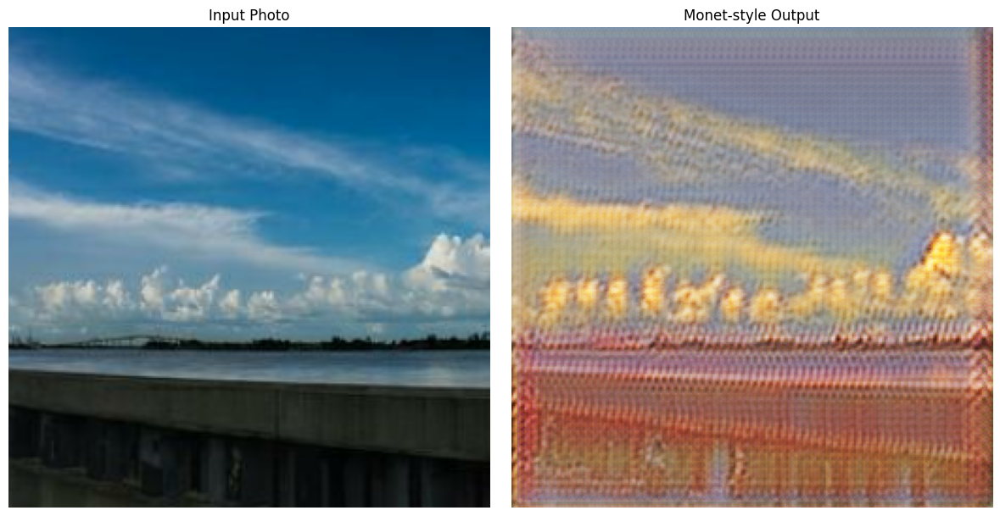

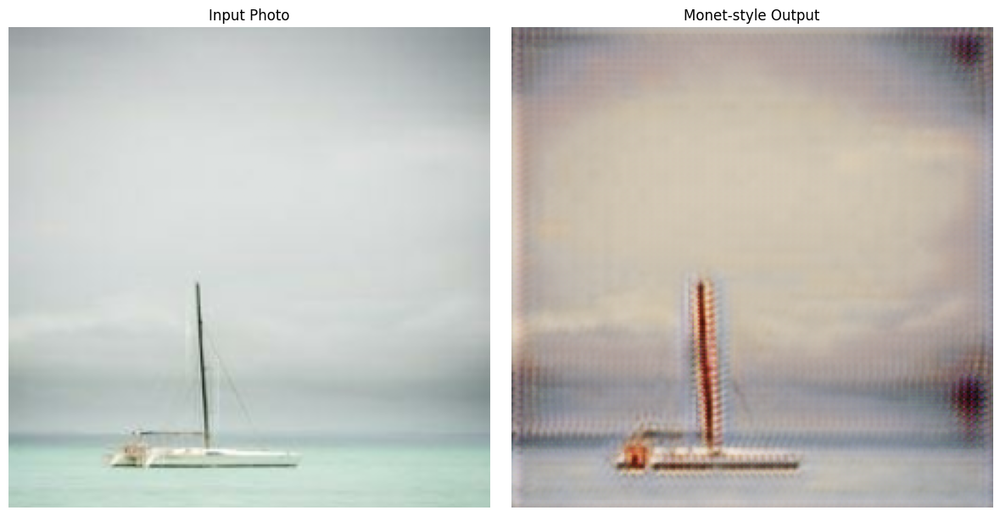

Epoch 2/15:   6%|▌         | 300/5000 [03:21<52:44,  1.49it/s]


Epoch 2/15
  Generator G (Photo → Monet) loss: 3.4876
  Generator F (Monet → Photo) loss: 3.4649
  Discriminator X (Photo) loss: 0.6305
  Discriminator Y (Monet) loss: 0.6383
  Time taken: 201.99 sec



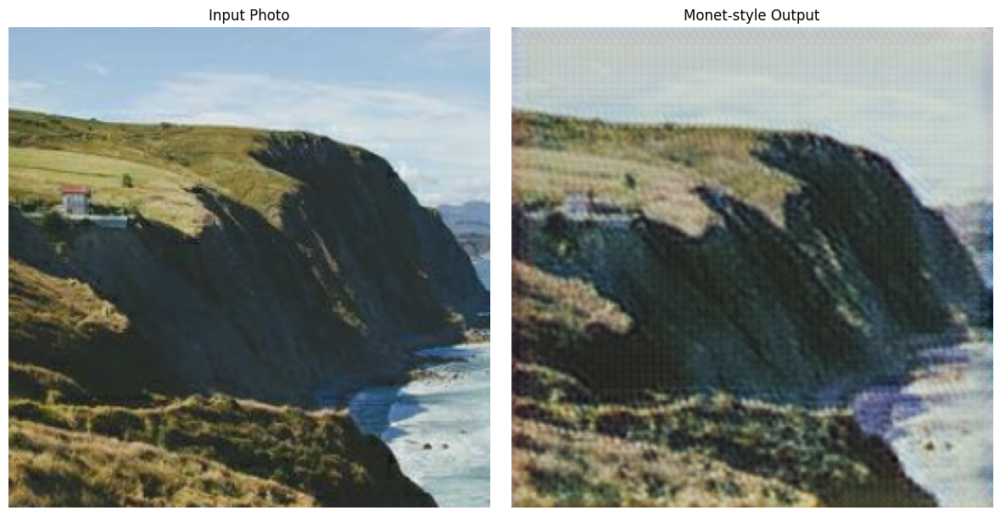

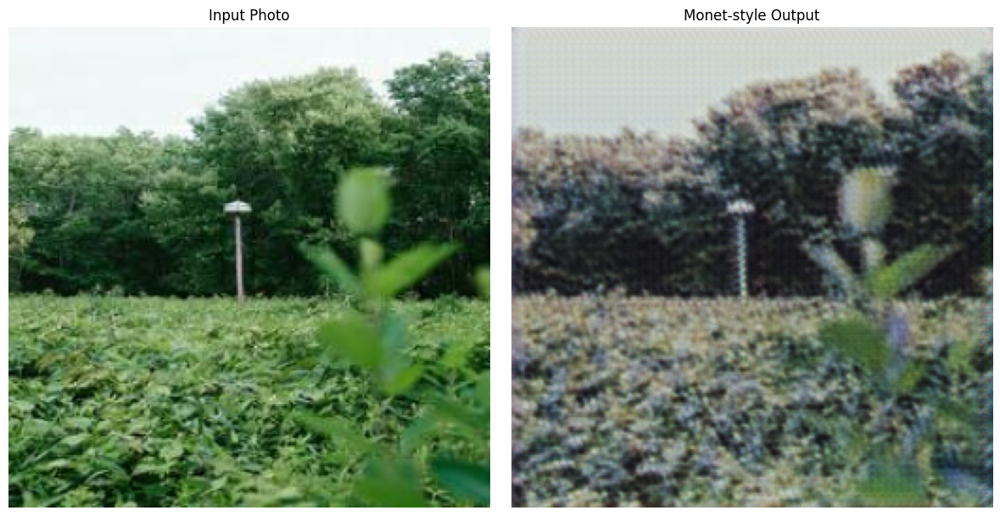

Epoch 3/15:   6%|▌         | 300/5000 [03:21<52:43,  1.49it/s]


Epoch 3/15
  Generator G (Photo → Monet) loss: 3.4985
  Generator F (Monet → Photo) loss: 3.4061
  Discriminator X (Photo) loss: 0.6420
  Discriminator Y (Monet) loss: 0.6274
  Time taken: 201.96 sec



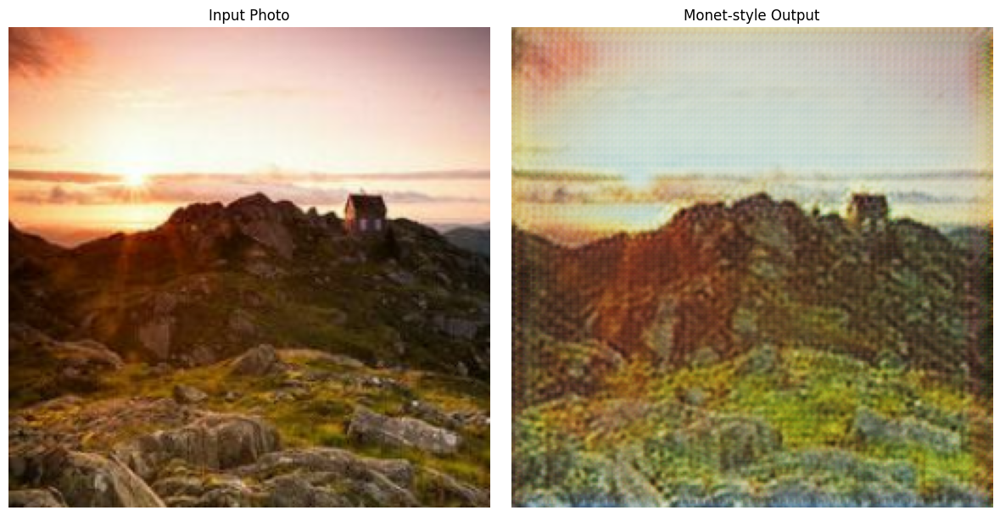

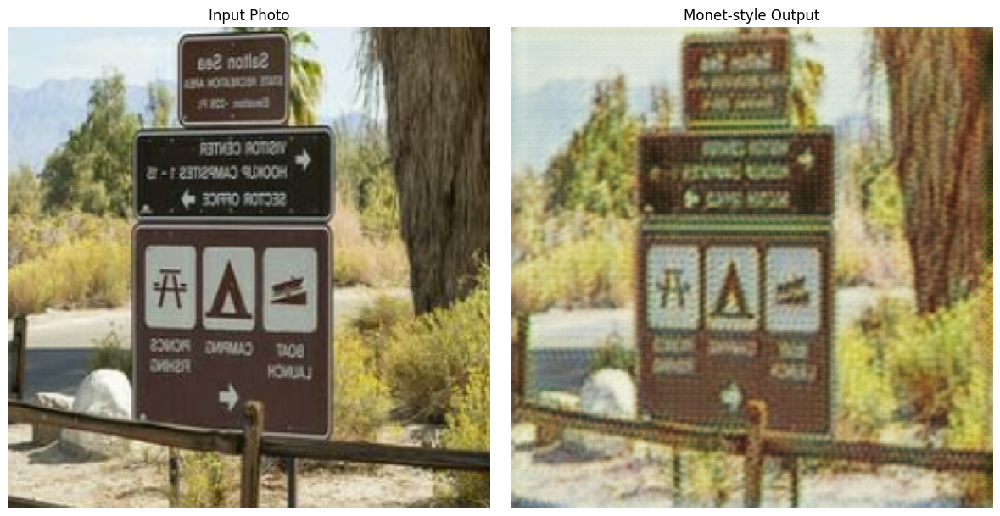

Epoch 4/15:   6%|▌         | 300/5000 [02:58<46:30,  1.68it/s]


Epoch 4/15
  Generator G (Photo → Monet) loss: 3.4241
  Generator F (Monet → Photo) loss: 3.4295
  Discriminator X (Photo) loss: 0.6327
  Discriminator Y (Monet) loss: 0.6261
  Time taken: 178.15 sec



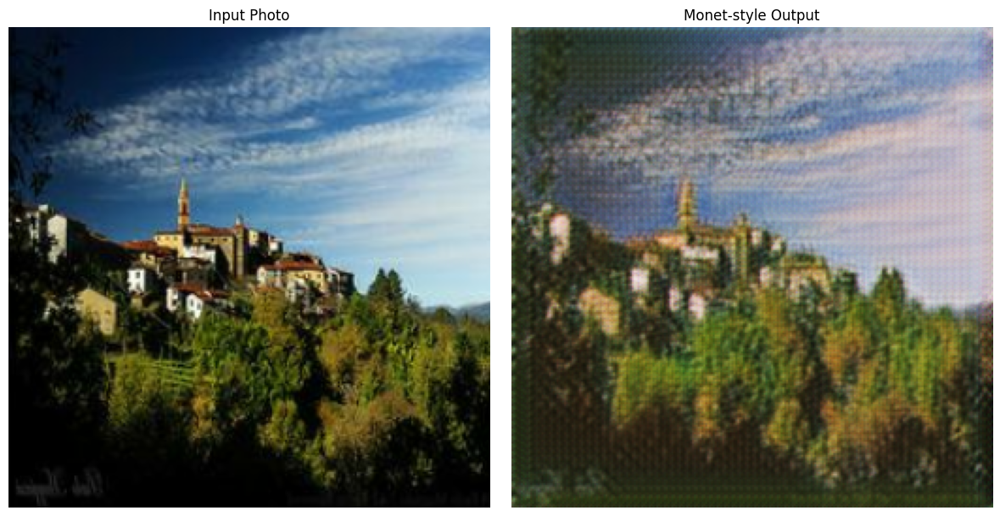

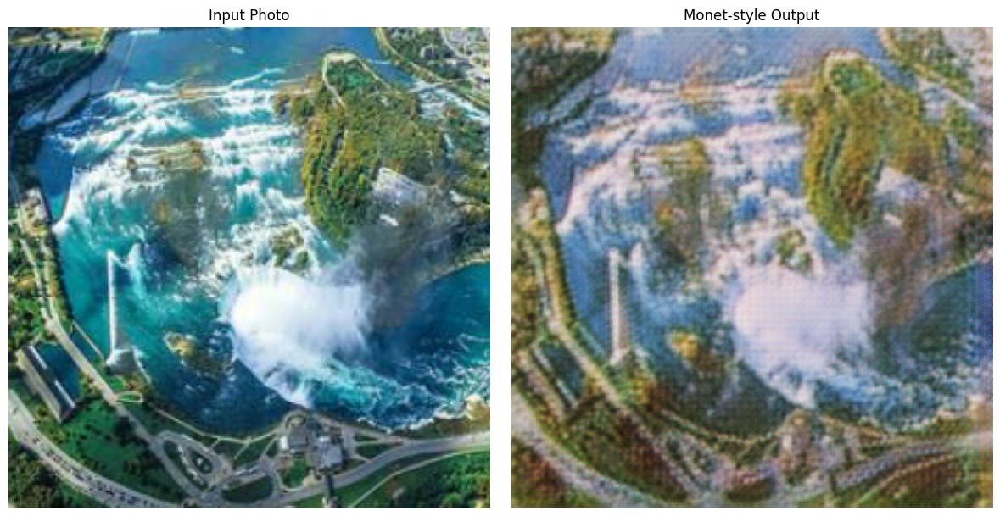

Epoch 5/15:   6%|▌         | 300/5000 [03:21<52:43,  1.49it/s]


Epoch 5/15
  Generator G (Photo → Monet) loss: 3.3018
  Generator F (Monet → Photo) loss: 3.2700
  Discriminator X (Photo) loss: 0.6254
  Discriminator Y (Monet) loss: 0.6253
  Time taken: 201.95 sec

Checkpoint saved at epoch 5


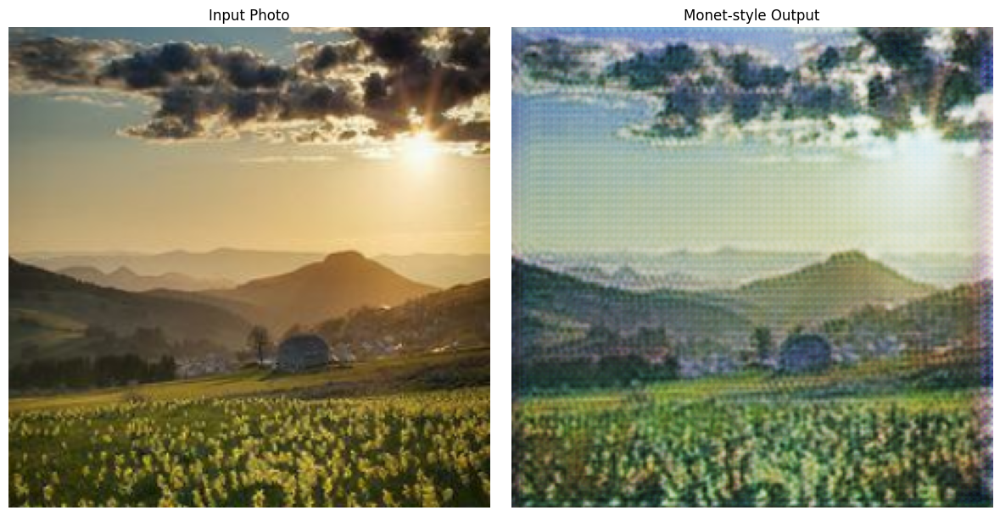

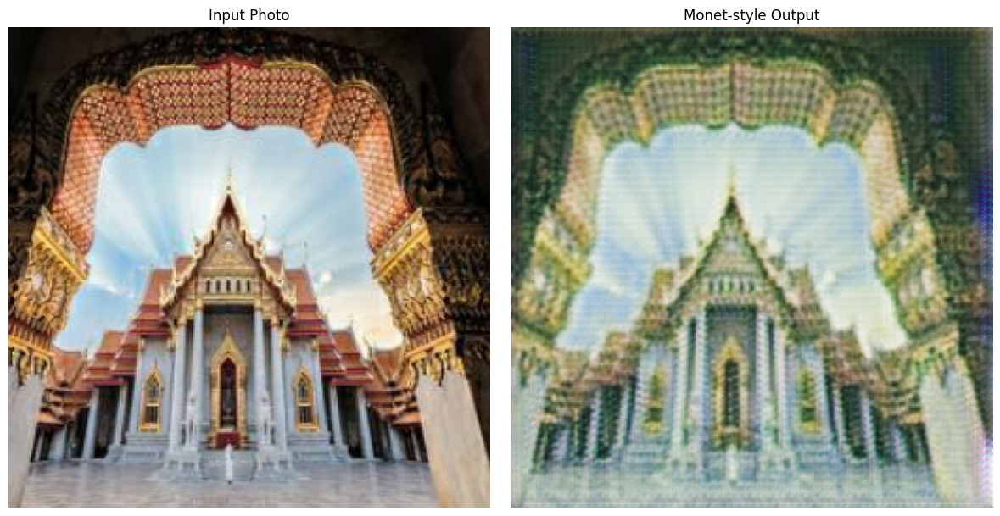

Epoch 6/15:   6%|▌         | 300/5000 [02:59<46:46,  1.67it/s]


Epoch 6/15
  Generator G (Photo → Monet) loss: 3.2770
  Generator F (Monet → Photo) loss: 3.2943
  Discriminator X (Photo) loss: 0.6350
  Discriminator Y (Monet) loss: 0.6306
  Time taken: 179.20 sec



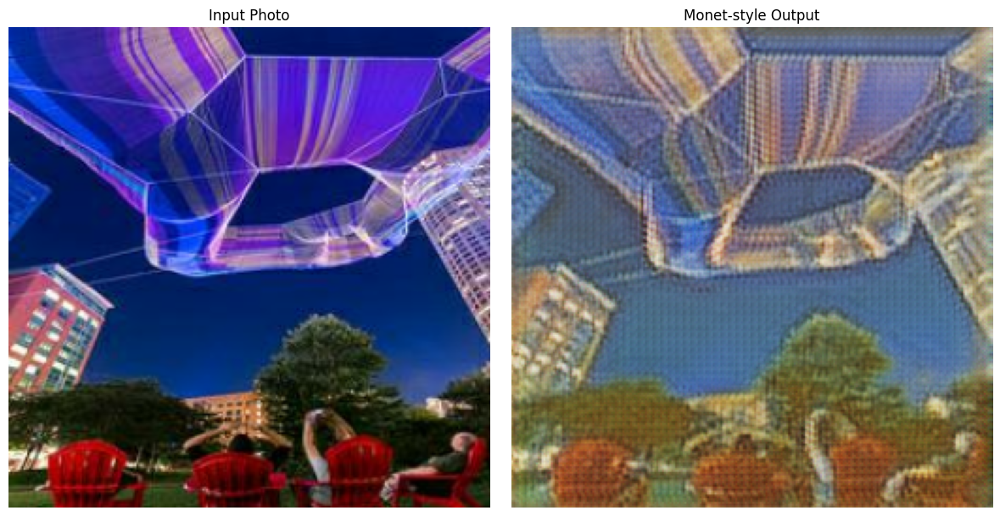

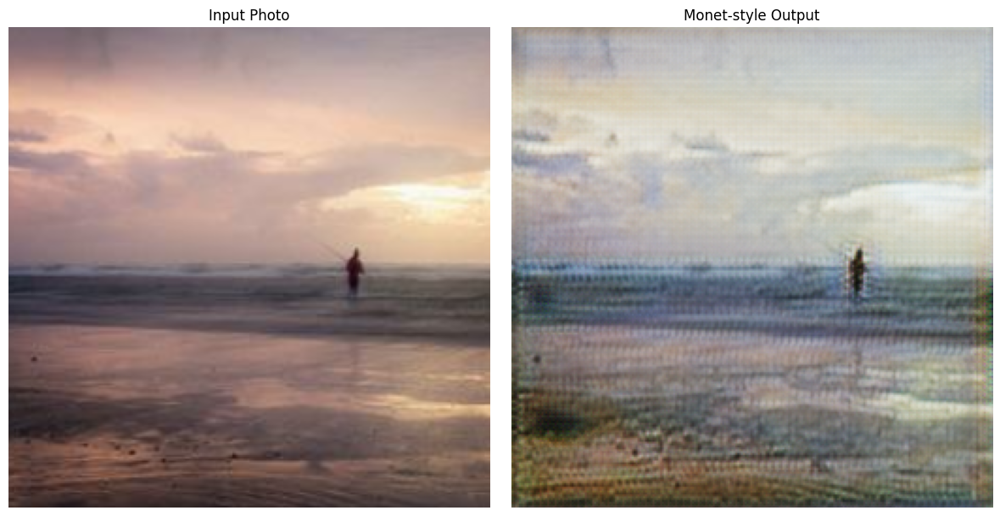

Epoch 7/15:   6%|▌         | 300/5000 [02:59<46:51,  1.67it/s]


Epoch 7/15
  Generator G (Photo → Monet) loss: 3.2544
  Generator F (Monet → Photo) loss: 3.2337
  Discriminator X (Photo) loss: 0.6370
  Discriminator Y (Monet) loss: 0.6389
  Time taken: 179.48 sec



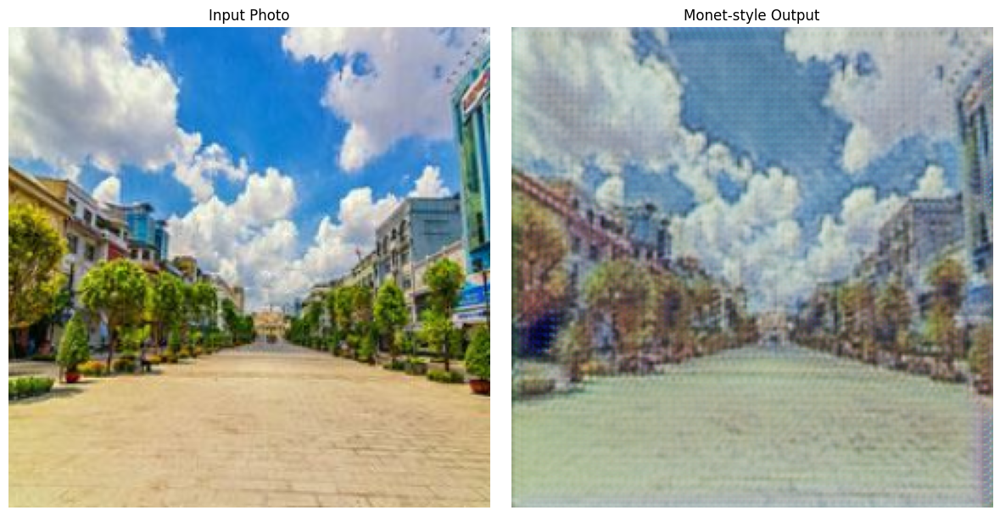

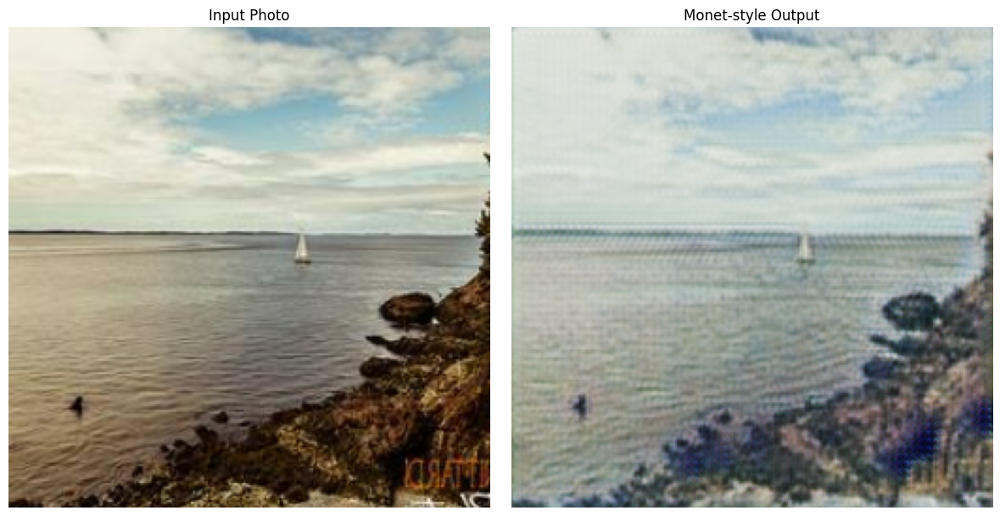

Epoch 8/15:   6%|▌         | 300/5000 [02:57<46:25,  1.69it/s]


Epoch 8/15
  Generator G (Photo → Monet) loss: 3.2352
  Generator F (Monet → Photo) loss: 3.2252
  Discriminator X (Photo) loss: 0.6349
  Discriminator Y (Monet) loss: 0.6182
  Time taken: 177.84 sec



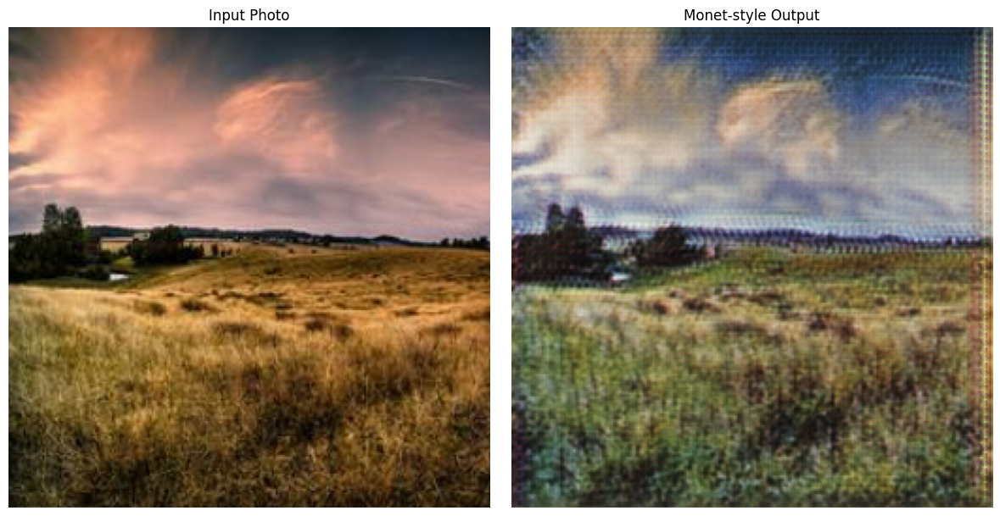

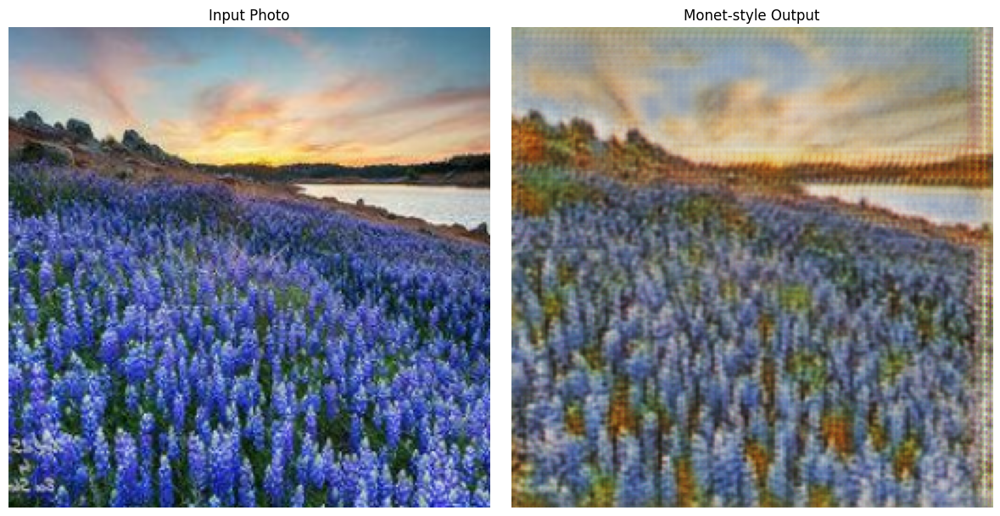

Epoch 9/15:   6%|▌         | 300/5000 [02:57<46:27,  1.69it/s]


Epoch 9/15
  Generator G (Photo → Monet) loss: 3.1863
  Generator F (Monet → Photo) loss: 3.1965
  Discriminator X (Photo) loss: 0.6344
  Discriminator Y (Monet) loss: 0.6326
  Time taken: 177.97 sec



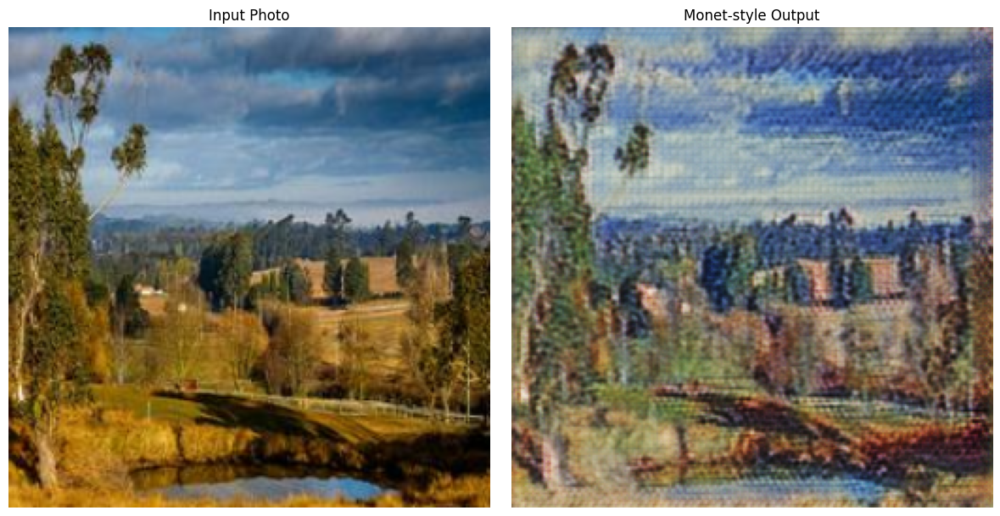

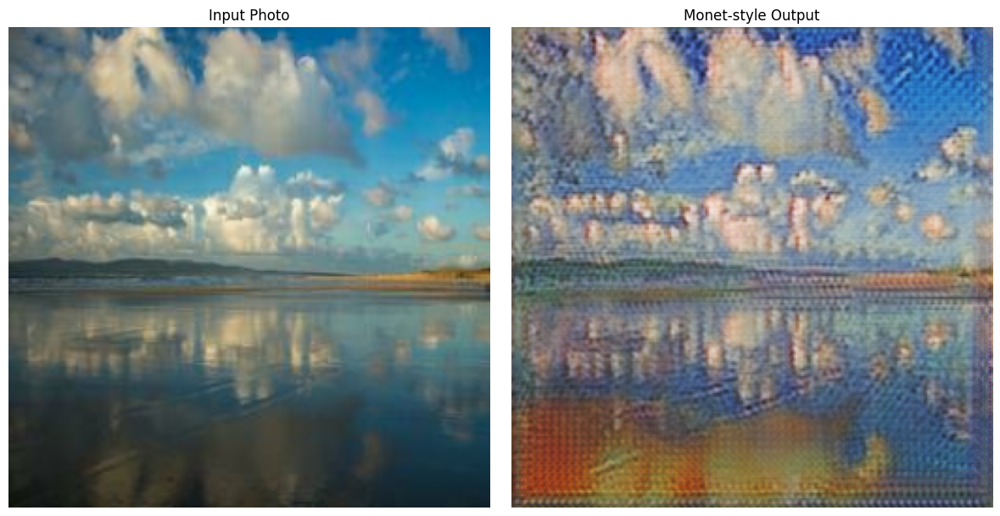

Epoch 10/15:   6%|▌         | 278/5000 [02:46<45:34,  1.73it/s]

In [ ]:
if __name__ == "__main__":
    main()

In [ ]:
# prompt: save ./content/results folder in drive

from google.colab import drive
drive.mount('/content/drive')

!zip -r /content/results.zip /content/results
!cp /content/results.zip /content/drive/MyDrive/GAN
